# intent classification pipeline

Based on CLINC150 dataset: 150 intent classes including an out of scope class (OOS).


In [67]:
from pathlib import Path
from psutil import cpu_count
import os
import warnings

from secrets import token_urlsafe
from torch.quantization import quantize_dynamic

import numpy as np
import transformers as tfm
from transformers import pipeline
import pandas as pd
from datasets import load_dataset
import torch
from optuna import trial

import onnxruntime.quantization as onnx_quant

import optim

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Baseline Intent Classifier
Bert-based

In [3]:
# starting model: BERT finetuned on the CLINC150 dataset
BERT_CKPT = "transformersbook/bert-base-uncased-finetuned-clinc"
pipe = pipeline("text-classification", model=BERT_CKPT)

Downloading: 100%|██████████| 8.18k/8.18k [00:00<00:00, 2.50MB/s]
Downloading: 100%|██████████| 438M/438M [00:41<00:00, 10.5MB/s] 
Downloading: 100%|██████████| 252/252 [00:00<00:00, 196kB/s]
Downloading: 100%|██████████| 232k/232k [00:00<00:00, 893kB/s] 
Downloading: 100%|██████████| 112/112 [00:00<00:00, 78.6kB/s]


In [4]:
query = "i would like to make a trip from Paris to Roma"
pipe(query)

[{'label': 'book_flight', 'score': 0.2848978638648987}]

## load dataset
[CLINC150](https://huggingface.co/datasets/clinc_oos)

In [5]:
clinc = load_dataset("clinc_oos", "plus")

intents = clinc["test"].features["intent"]

Dataset clinc_oos downloaded and prepared to /Users/spayot/.cache/huggingface/datasets/clinc_oos/plus/1.0.0/abcc41d382f8137f039adc747af44714941e8196e845dfbdd8ae7a7e020e6ba1. Subsequent calls will reuse this data.


100%|██████████| 3/3 [00:00<00:00, 782.08it/s]


## Creating Performance Benchmark

In [8]:
# refactored
# create object recording all performances
METRICS_PATH = "../data/outputs/chp08_perf_metrics.pkl"

perf_metrics = optim.perf.PerfMetrics(path=METRICS_PATH)

def pb_run_log_plot(pm: optim.perf.PerfMetrics, optim_type: str, model_ckpt: str) -> None:
    """run benchmark. update metrics report and save. plot metrics"""
    pipe = tfm.pipeline("text-classification", model_ckpt)

    pb = optim.perf.PerformanceBenchmark(
        pipe, 
        clinc["test"], 
        optim_type=optim_type,
        class_label="intent",
        )
    pm.update(pb.run_benchmark())

    pm.to_pkl()

    optim.plot.plot_metrics(perf_metrics, optim_type)




Model Size (MB):      418.2
Avg. Latency (ms): 40.85 +/- 1.47
Model Accuracy:       86.73%


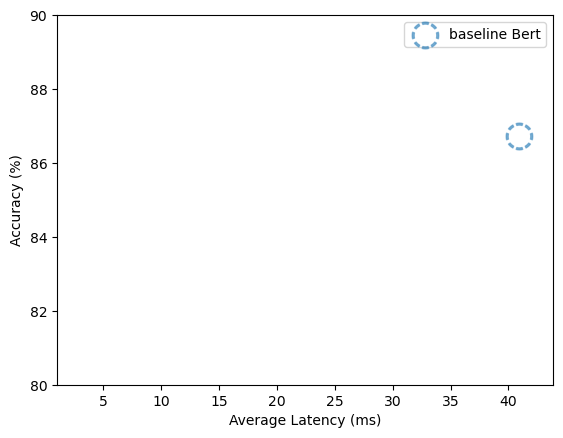

In [10]:
pb_run_log_plot(perf_metrics, optim_type="baseline Bert", model_ckpt=BERT_CKPT)


## Knowledge Distillation
* create custom Trainer mixing a cross entropy loss from ground truth labels and a Kullback-Leibler divergence loss

### prepare dataset

In [11]:
STUDENT_CKPT = "distilbert-base-uncased"
student_tokenizer = tfm.AutoTokenizer.from_pretrained(STUDENT_CKPT)

def tokenize_text(batch):
    return student_tokenizer(batch["text"], truncation=True)

clinc_enc = clinc.map(tokenize_text, batched=True, remove_columns=["text"])
clinc_enc = clinc_enc.rename_column("intent", "labels")




Loading cached processed dataset at /Users/spayot/.cache/huggingface/datasets/clinc_oos/plus/1.0.0/abcc41d382f8137f039adc747af44714941e8196e845dfbdd8ae7a7e020e6ba1/cache-fea0c49e7fa93460.arrow
100%|██████████| 4/4 [00:00<00:00, 15.23ba/s]
Loading cached processed dataset at /Users/spayot/.cache/huggingface/datasets/clinc_oos/plus/1.0.0/abcc41d382f8137f039adc747af44714941e8196e845dfbdd8ae7a7e020e6ba1/cache-185506aa0d5d92e3.arrow


In [12]:
# define metrics
def compute_metrics(pred: tfm.EvalPrediction) -> dict:
    predictions, labels = pred
    predictions = np.argmax(predictions, axis=-1)
    return optim.perf.accuracy_score.compute(predictions=predictions, references=labels)

In [15]:
# test compute_metrics
pred = tfm.EvalPrediction(predictions=np.random.random((5,3)), label_ids=np.array([1,2,1,2,0]))
compute_metrics(pred)

{'accuracy': 0.4}

In [16]:
# custom Trainer to perform knowledge distillation task
BATCH_SIZE = 48
FINETUNED_STUDENT_CKPT = "../models/distilbert-base-uncased-finetuned-clinc"

config = {
    "output_dir": FINETUNED_STUDENT_CKPT,
    "num_train_epochs": 5,
    "learning_rate": 2e-5,
    "per_device_train_batch_size": BATCH_SIZE,
    "per_device_eval_batch_size": BATCH_SIZE,
    "weight_decay": 0.01,
    "save_steps": 1e6,
    "evaluation_strategy": "epoch",
    "disable_tqdm": False,
    "push_to_hub": False,
    "log_level": "error",
    "alpha": 1,
    "temperature": 2,
}

student_training_args = optim.distillation.DistillationTrainingArguments(**config)

In [17]:
# create a student model initializer (classification layer is randomly initialized)
student_config = tfm.AutoConfig.from_pretrained(
    STUDENT_CKPT, 
    num_labels=intents.num_classes,
    id2label=pipe.model.config.id2label,
    label2id=pipe.model.config.label2id,
)

device = torch.device("mps" if torch.cuda.is_available() else "cpu")

def student_init():
    return tfm.AutoModelForSequenceClassification.from_pretrained(
        STUDENT_CKPT, config=student_config,
    ).to(device)

# instantiate the teacher model (classification layer is already finetuned)
TEACHER_CKPT = "transformersbook/bert-base-uncased-finetuned-clinc"
teacher_model = tfm.AutoModelForSequenceClassification.from_pretrained(
    TEACHER_CKPT, num_labels=intents.num_classes
).to(device)

# instantiate trainer

distilbert_trainer = optim.distillation.DistillationTrainer(
    model_init=student_init,
    teacher_model=teacher_model,
    args=student_training_args,
    train_dataset=clinc_enc["train"],
    eval_dataset=clinc_enc["validation"],
    compute_metrics=compute_metrics,
    tokenizer=student_tokenizer,
)

distilbert_trainer.train()



/Users/spayot/miniforge3/envs/tfm8/lib/python3.9/site-packages/transformers/optimization.py:306: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
 20%|██        | 318/1590 [04:29<14:48,  1.43it/s]

{'eval_loss': 3.2787506580352783, 'eval_accuracy': 0.7458064516129033, 'eval_runtime': 26.8528, 'eval_samples_per_second': 115.444, 'eval_steps_per_second': 2.421, 'epoch': 1.0}


 31%|███▏      | 500/1590 [06:43<12:54,  1.41it/s]  

{'loss': 3.78, 'learning_rate': 1.371069182389937e-05, 'epoch': 1.57}


                                                  
 40%|████      | 636/1590 [08:50<11:24,  1.39it/s]

{'eval_loss': 1.870642066001892, 'eval_accuracy': 0.8338709677419355, 'eval_runtime': 26.8278, 'eval_samples_per_second': 115.552, 'eval_steps_per_second': 2.423, 'epoch': 2.0}


                                                    
 60%|██████    | 954/1590 [13:16<07:11,  1.48it/s]

{'eval_loss': 1.162010669708252, 'eval_accuracy': 0.8941935483870967, 'eval_runtime': 26.8198, 'eval_samples_per_second': 115.586, 'eval_steps_per_second': 2.424, 'epoch': 3.0}


 63%|██████▎   | 1000/1590 [13:50<07:04,  1.39it/s] 

{'loss': 1.6915, 'learning_rate': 7.421383647798742e-06, 'epoch': 3.14}


                                                   
 80%|████████  | 1272/1590 [17:39<03:46,  1.41it/s]

{'eval_loss': 0.8613191246986389, 'eval_accuracy': 0.91, 'eval_runtime': 26.8702, 'eval_samples_per_second': 115.369, 'eval_steps_per_second': 2.419, 'epoch': 4.0}


 94%|█████████▍| 1500/1590 [20:29<01:00,  1.48it/s]

{'loss': 0.9057, 'learning_rate': 1.1320754716981133e-06, 'epoch': 4.72}


                                                   
100%|██████████| 1590/1590 [22:03<00:00,  1.20it/s]

{'eval_loss': 0.7781001329421997, 'eval_accuracy': 0.9161290322580645, 'eval_runtime': 26.8771, 'eval_samples_per_second': 115.34, 'eval_steps_per_second': 2.418, 'epoch': 5.0}
{'train_runtime': 1323.3693, 'train_samples_per_second': 57.618, 'train_steps_per_second': 1.201, 'train_loss': 2.0489570953561076, 'epoch': 5.0}


TrainOutput(global_step=1590, training_loss=2.0489570953561076, metrics={'train_runtime': 1323.3693, 'train_samples_per_second': 57.618, 'train_steps_per_second': 1.201, 'train_loss': 2.0489570953561076, 'epoch': 5.0})

In [18]:
distilbert_trainer.save_model()

### benchmark the distilled pipeline

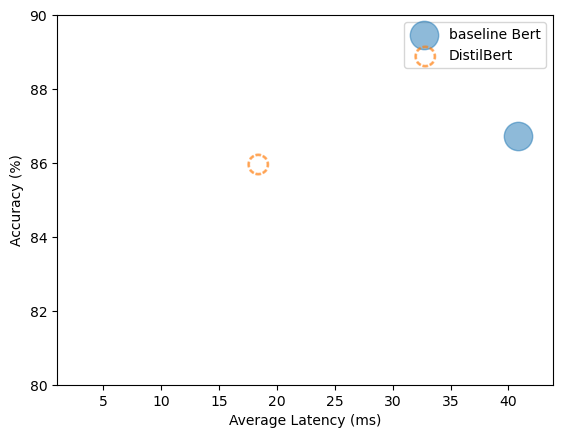

In [20]:
pb_run_log_plot(perf_metrics, optim_type="DistilBert", model_ckpt=FINETUNED_STUDENT_CKPT)

Strong improvement in terms of Latency, with limited reduction in Accuracy.

## HyperParameter Optimization

In [ ]:
def hp_space(trial):
    return {
        "num_train_epochs": trial.suggest_int("num_train_epochs", 5, 10),
        "alpha": trial.suggest_float("alpha", 0,1),
        "temperature": trial.suggest_int("temperature", 2, 20),
        }

best_run = distilbert_trainer.hyperparameter_search(n_trials=20, direction="maximize", hp_space=hp_space)

print(best_run)

In [24]:
best_run.hyperparameters

{'num_train_epochs': 10, 'alpha': 0.6845678469353762, 'temperature': 10}

### Execute Run with best parameters

In [ ]:
for k,v in best_run.hyperparameters.items():
    setattr(student_training_args, k, v)

DISTILLED_CKPT = "../models/distilbert-base-uncased-hpopt-clinc"
student_training_args.output_dir = DISTILLED_CKPT

# instantiate trainer with optimal hyperparameters
distil_trainer = optim.distillation.DistillationTrainer(
    model_init=student_init,
    teacher_model=teacher_model,
    args=student_training_args,
    train_dataset=clinc_enc["train"],
    eval_dataset=clinc_enc["validation"],
    compute_metrics=compute_metrics,
    tokenizer=student_tokenizer,
)

distil_trainer.train();

distil_trainer.save_model()

Model Size (MB):      255.9
Avg. Latency (ms): 18.52 +/- 1.40
Model Accuracy:       85.98%


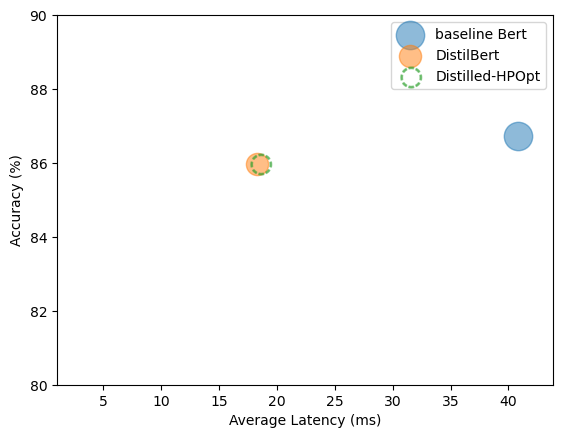

In [27]:
pb_run_log_plot(
    perf_metrics, 
    optim_type="Distilled-HPOpt", 
    model_ckpt=DISTILLED_CKPT)
    

improvement is rather slight
## Quantization
note: if need to save quantized model: check this ref: https://discuss.huggingface.co/t/pegasus-model-weights-compression-pruning/6381/7

In [55]:
BACKEND = "qnnpack"

model = tfm.AutoModelForSequenceClassification.from_pretrained(DISTILLED_CKPT).to("cpu")

# setting up proper backend
torch.backends.quantized.engine = BACKEND


model_quantized = torch.quantization.quantize_dynamic(
    model,  # the original model
    {torch.nn.Linear},  # a set of layers to dynamically quantize
    dtype=torch.qint8)  # the target dtype for quantized weights

tokenizer = tfm.AutoTokenizer.from_pretrained(DISTILLED_CKPT)

Model Size (MB):      132.4


[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is 

Avg. Latency (ms): 19.10 +/- 2.05


[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is 

Model Accuracy:       86.38%


[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is set to true; this may change in a future release. (function apply_dynamic_impl)
[W qlinear_dynamic.cpp:239] Warning: Currently, qnnpack incorrectly ignores reduce_range when it is 

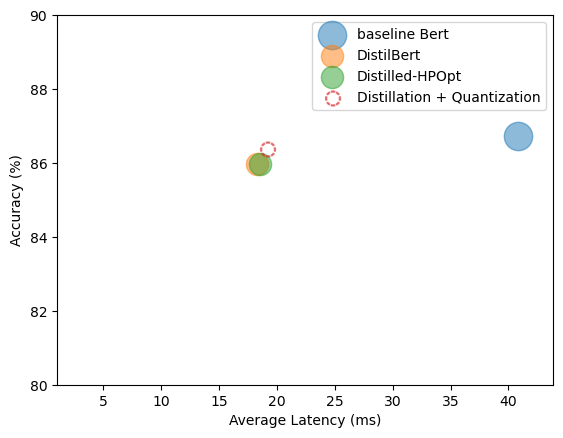

In [56]:
optim_type = "Distillation + Quantization"
pipe = tfm.pipeline("text-classification", 
    model=model_quantized, 
    tokenizer=tokenizer)

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    pb = optim.perf.PerformanceBenchmark(pipe, clinc["test"], optim_type=optim_type)

perf_metrics.update(pb.run_benchmark())

perf_metrics.to_pkl()

optim.plot.plot_metrics(perf_metrics, optim_type)

In [58]:
pd.DataFrame.from_dict(perf_metrics.metrics).round(3)

,baseline Bert,DistilBert,Distilled-HPOpt,Distillation + Quantization
size,418.164,255.888,255.888,132.397
latency_ms_avg,40.847,18.243,18.519,19.100
latency_ms_std,1.473,0.769,1.403,2.050
accuracy,0.867,0.860,0.860,0.864


The Quantized Model saves about ~20% on latency here, but 
## Optimizing Inference with ONNX and ONNX Runtime
### Save model in ONNX format

In [59]:
os.environ["OMP_NUM_THREADS"] = f"{cpu_count()}"
os.environ["OMP_WAIT_POLICY"] = "ACTIVE"

onnx_model_path = Path("../models/onnx-distilbert-base/model.onnx")

tfm.convert_graph_to_onnx.convert(
    framework="pt",
    model=DISTILLED_CKPT,
    tokenizer=tokenizer,
    output=onnx_model_path,
    opset=12,
    pipeline_name="text-classification",
)


ONNX opset version set to: 12
Loading pipeline (model: ../models/distilbert-base-uncased-hpopt-clinc, tokenizer: PreTrainedTokenizerFast(name_or_path='../models/distilbert-base-uncased-hpopt-clinc', vocab_size=30522, model_max_len=512, is_fast=True, padding_side='right', truncation_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}))
Creating folder ../models/onnx-distilbert-base-quantified
Using framework PyTorch: 1.13.1
Found input input_ids with shape: {0: 'batch', 1: 'sequence'}
Found input attention_mask with shape: {0: 'batch', 1: 'sequence'}
Found output output_0 with shape: {0: 'batch'}
Ensuring inputs are in correct order
head_mask is not present in the generated input list.
Generated inputs order: ['input_ids', 'attention_mask']


### load model for ONNX RunTime

In [60]:
# load model with ONNX
onnx_model = optim.onnx.create_model_for_provider(onnx_model_path)

#### evaluate 

In [61]:
inputs = clinc_enc["test"][:1]
label = inputs.pop("labels")[0]
logits_onnx = onnx_model.run(None, inputs)[0]

preds = np.argmax(logits_onnx)
f"prediction: {preds}, true label: {label}"

'prediction: 61, true label: 61'

In [62]:
# create pipeline
pipe = optim.onnx.OnnxPipeline(model=onnx_model, tokenizer=tokenizer, id2labels=intents.int2str)

pipe(query)

[{'label': 'book_flight', 'score': 0.26611328}]

In [63]:
optim_type = "Distillation + ORT"
pb = optim.perf.OnnxPerformanceBenchmark(pipe, clinc["test"], optim_type=optim_type, model_path=onnx_model_path)
perf_metrics.update(pb.run_benchmark())

Model Size (MB):      255.0
Avg. Latency (ms): 16.39 +/- 0.75
Model Accuracy:       85.98%


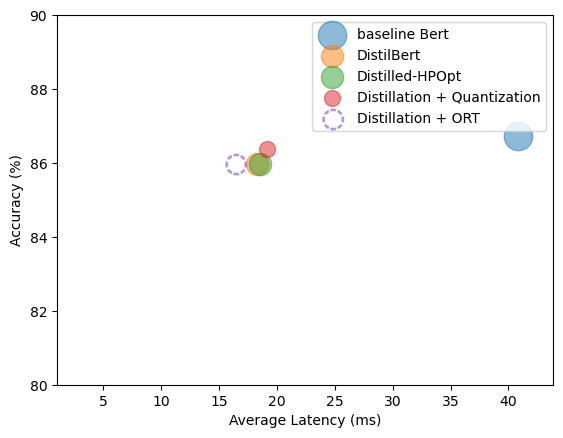

In [64]:
optim.plot.plot_metrics(perf_metrics, optim_type)

In [71]:
model_input = "../models/onnx-distilbert-base/model.onnx"
model_output = "../models/onnx-distilbert-base/model.quant.onnx"
onnx_quant.quantize_dynamic(model_input, model_output, weight_type=onnx_quant.QuantType.QInt8)



Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.0/attention/MatMul]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.0/attention/MatMul_1]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.1/attention/MatMul]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.1/attention/MatMul_1]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.2/attention/MatMul]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.2/attention/MatMul_1]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.3/attention/MatMul]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.3/attention/MatMul_1]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.4/attention/MatMul]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.4/attention/MatMul_1]
Ignore MatMul due to non constant B: /[/distilbert/transformer/layer.5/attention/MatMul]
Ignore MatM

Model Size (MB):       64.0
Avg. Latency (ms): 11.10 +/- 0.22
Model Accuracy:       86.38%


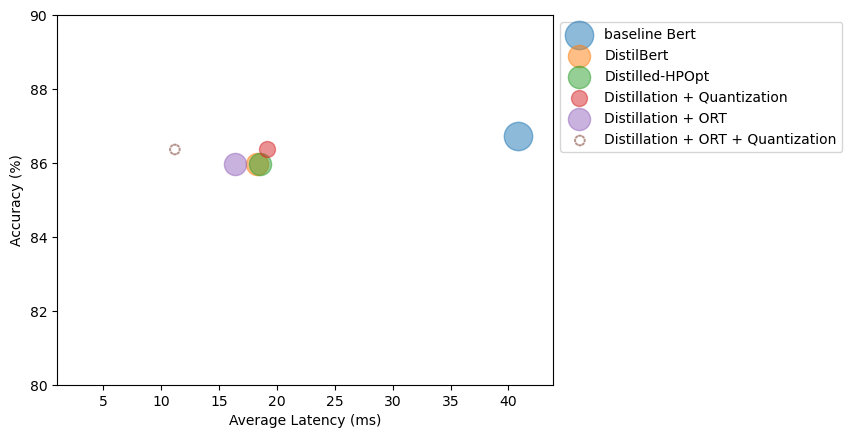

In [70]:
onnx_quantized_model = optim.onnx.create_model_for_provider(model_output)
pipe = optim.onnx.OnnxPipeline(onnx_quantized_model, tokenizer=tokenizer, id2labels=intents.int2str)

optim_type = "Distillation + ORT + Quantization"
pb = optim.perf.OnnxPerformanceBenchmark(pipe, clinc["test"], optim_type, model_path=model_output)

perf_metrics.update(pb.run_benchmark())

optim.plot.plot_metrics(perf_metrics, optim_type)

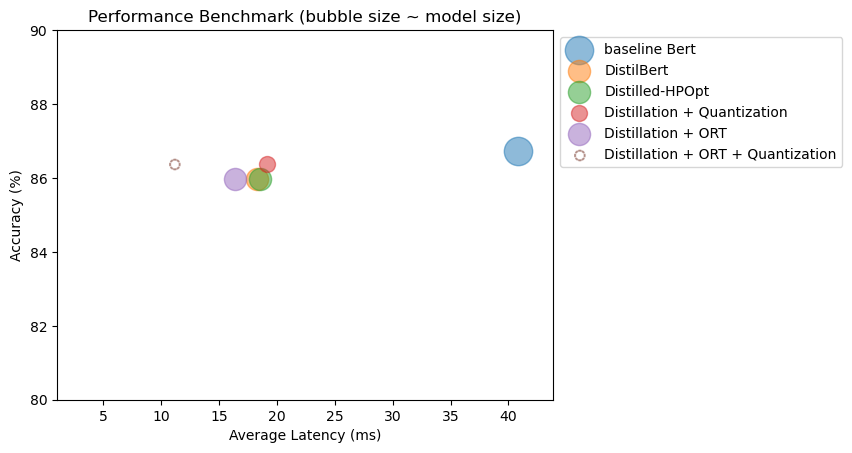

In [85]:
fig = optim.plot.plot_metrics(perf_metrics, optim_type)
fig.savefig("../images/perf_comparison.jpg")

In [82]:
pd.DataFrame(perf_metrics.metrics).T

,size,latency_ms_avg,latency_ms_std,accuracy
baseline Bert,418.163884,40.847032,1.473065,0.867273
DistilBert,255.888127,18.242567,0.768640,0.859818
Distilled-HPOpt,255.888127,18.519251,1.402813,0.859818
Distillation + Quantization,132.396855,19.099900,2.049541,0.863818
Distillation + ORT,255.000000,16.389642,0.747893,0.859818
Distillation + ORT + Quantization,64.000000,11.095215,0.215773,0.863818
